# Python Chemistry Networks

With the little bit of exploring done earlier. We can now refactor some things to make things easier and more robust.

### TODO:

+ Refactor plotting functions. Perhaps individual plot elements could be generated as traces and combined with a mother plotting function.
+ Redo and add comments. Some things changed in a numpy overhaul...

### Import Packages and Set Global Constants

It is good form to import all needed packages at the top of any given Python file.

I will also set some dictionaries up to facilitate some varable assignments.

In [39]:
# Import basic Python tools.
import itertools
import collections
import random
import functools

# Import data science packages.
import numpy as np
import networkx as nx

# Import plotting tools.
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go

# Import Bokeh plotting tools. For demoing.
from ipywidgets import interact

from bokeh.io import push_notebook, show, output_notebook
from bokeh.plotting import figure
from bokeh.models.mappers import LogColorMapper
from bokeh.models import ColorBar
output_notebook()

# Import progress bars.
from tqdm import tnrange, tqdm_notebook

Loading BokehJS ...

In [40]:
# Setup matplotlib for nice notebook output.
%matplotlib inline

In [41]:
# What Python version are we using? What OS are we on?
import sys
print(sys.version)

3.6.4 |Anaconda custom (64-bit)| (default, Jan 16 2018, 18:10:19) 
[GCC 7.2.0]


In [42]:
# Enable plotly notebook mode.
init_notebook_mode()

Running the above command I encountered the following error:

```
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.
```

This can be fixed by setting the corresponding jupyter notebook config variable.

Or by launching jupyter notebook with another option, as shown below.

```
jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10
```

### Define Global Dictionaries

Store things like our preffered atom radii and colors for plotting.

In [43]:
ELEMENT_COLORS = {
    'H': 'red',
    'O': 'blue',
}

ELEMENT_SIZES = {
    'H': 25,
    'O': 60,
}

## Create Graph from XYZ file

It is clear that we need to generate networks from snapshot files. It makes the most sense to me to generate one network per snapshot.

Also considered are the formats of these `.xyz` files. Which have an atom count then an empty line in them.

In [44]:
def create_graph_from_xyz(xyz_filepath):
    """Creates a new networkx graph object from the given file.
    
    :param xyz_filepath:
        The filepath, as a string, from which the network will
        be constructed.
    
    :returns:
        A networkx graph object.
    """
    
    # Open the file and read the lines therein.
    with open(xyz_filepath) as in_file:
        
        # Drop the first two lines of the .xyz file.  
        data = in_file.readlines()[2:]
        
    # Create the empty network to be returned.
    graph = nx.Graph()
    
    # Iterate through the data, and generate a node for each line.
    for index, line in enumerate(data):
        
        # Split the string by whitespace.
        line = line.split()
        
        # Get the element type.
        node_element = line[0]
        
        # Get the x, y, z coordinates.
        x_val = np.float(line[1])
        y_val = np.float(line[2])
        z_val = np.float(line[3])
        
        # Create the node within the new graph.
        graph.add_node(
            # Save nodes by index.
            node_for_adding=index,
            
            # Remaining arguments passed here will be passed to
            # the node as key: value pair attributes.
            element=node_element,
            x=x_val,
            y=y_val,
            z=z_val,
            size=ELEMENT_SIZES[node_element],
            color=ELEMENT_COLORS[node_element]
        )
        
    # Return the graph generated.
    return graph

In [45]:
# Test this new function.
TEST_GRAPH = create_graph_from_xyz('data/realwater.xyz')

#### Get (x, y, z) coordinates from a node

I will almost always want all three of these values if any are called. Let us build a function to simplify this process.

In [46]:
def get_node_xyz(in_node, graph):
    """Returns a tuple of x, y, z values from a given
    graph and node pair. These attributes must already be
    defined in the node.
    
    :param in_node:
        A networkx node object contained within the graph
        input above.
    
    :param graph:
        A networkx graph object.
        
    :returns:
        A tuple of the x, y, z coordinates of the node.
    """
    # Find the coordinates.
    xx = graph.node('x')[in_node]
    yy = graph.node('y')[in_node]
    zz = graph.node('z')[in_node]
    
    # Return the tuple of them.
    return np.array((xx, yy, zz))

### Find box size

Find the minimum and maximum values of the input to find the box size.

In [47]:
def get_box_size(in_graph):    
    # Get the x, y, z coordinates from the graph nodes.
    xyz_vals = np.array([get_node_xyz(n, in_graph) for n in in_graph])
    
    # Get the maximum and minumum for the period length.
    max_coords = np.amax(xyz_vals, axis=0)
    min_coords = np.amin(xyz_vals, axis=0)
    
    # Calculate the size of the box.
    period_size = max_coords - min_coords
    
    return period_size

### Calculate the distance matrix

I would rather store a 1D array in each node as opposed to having the entire distance matrix as a separate object. For the purposes of calculating the matrix however, a separate function should be preferred.

In [48]:
def periodic_dist_vector(psa, psb, pL):
    """Calculate the distance vectors between two sets of points under
    periodic conditions.
    
    :param psa:
        An array of coordinate vectors.

    :param psb:
        An array of coordinate vectors.
    
    :param pL:
        The period length.
    """
    diff_arrays = psa[..., None] - psb.T[None, ...]
    diff_arrays = np.moveaxis(diff_arrays, -1, 0)
    return np.remainder(diff_arrays + pL / 2.0, pL) - pL / 2.0

In [49]:
def euclidean_dist(dist_vector_array):
    """Calculate the euclidean distance of the value.
    """
    return np.linalg.norm(dist_vector_array, axis=-1)

#### Calculate the distance matrix

In [50]:
def periodic_calculate_distance_matrix(in_graph):
    """Calculate and return a distance matrix based a given graph.
    
    :param in_graph:
        A networkx graph object. The nodes in this graph must have
        x, y, and z attributes for this function to work.
        
    :returns:
        A distance matrix as a numpy array.
    """
    
    # Find the length / number of atoms in the system.
    atoms_total = len(in_graph)

    # Create a matrix of zeros the size of our edges.
    distance_matrix = np.zeros((atoms_total, atoms_total))
    
    # Get the x, y, z coordinates from the graph nodes.
    xyz_vals = np.array([get_node_xyz(n, in_graph) for n in in_graph])
    
    # Get the maximum and minumum for the period length.
    max_coords = np.amax(xyz_vals, axis=0)
    min_coords = np.amin(xyz_vals, axis=0)
    
    # Calculate the size of the box.
    period_size = max_coords - min_coords

    # Calculate the periodic distance vectors.
    periodic_dist_vectors = periodic_dist_vector(xyz_vals, xyz_vals, period_size)
    
    # Calculate the euclidean distances of these vectors.
    e_distances = euclidean_dist(periodic_dist_vectors)
    
    return (periodic_dist_vectors, e_distances)

In [51]:
TBG = create_graph_from_xyz('data/realwater.xyz')

In [52]:
TPV, TED = periodic_calculate_distance_matrix(TBG)

In [53]:
def visualize_distance_matrix(matrix):
    """View a given distance matrix as an image.
    
    Usefull for identifying bad data, as artifacts can
    be seen.
    """
    
    # Create the figure and axis to plot on.
    fig, ax = plt.subplots(figsize=(10,10))
    
    # Draw the image.
    cax = ax.imshow(matrix)
    
    # Add a color bar.
    fig.colorbar(cax)
        
    # Show the plot.
    plt.show()

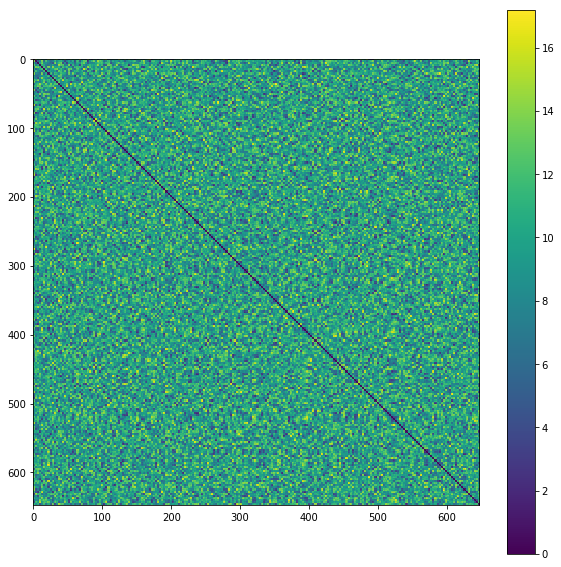

In [54]:
visualize_distance_matrix(TED)

In [55]:
def bokeh_distance_matrix(matrix):
    """View a given distance matrix as an image.
    https://bokeh.pydata.org/en/latest/docs/user_guide/annotations.html#color-bars
    """
    
    color_mapper = LogColorMapper(palette="Viridis256", low=0.0, high=17.0)

    plot = figure(
        x_range=(0,matrix.shape[0]),
        y_range=(0,matrix.shape[1]), 
        toolbar_location=None)
    
    plot.image(
        image=[matrix], 
        color_mapper=color_mapper,
        dh=[matrix.shape[0]], 
        dw=[matrix.shape[1]],
        x=[0], 
        y=[0])

    color_bar = ColorBar(color_mapper=color_mapper,
                         label_standoff=12, border_line_color=None, location=(0,0))
    plot.add_layout(color_bar, 'right')
    show(plot)

In [56]:
bokeh_distance_matrix(TED)

In [57]:
bokeh_distance_matrix(TED)

### Add distance array to nodes

This function adds a 'slice' of the distance array to each corresponding node. Essentially the each node will have a 1D array that contains the euclidean distance to every other point. This list is indexed the same way the graph nodes are indexed.

In [58]:
def add_distance_array_to_nodes(graph):
    """Stores a 1D array of distances to other atoms on the
    corresponding node within graph. The distance matrix
    creation function will be called by this function.
    
    The graph and distance_matrix objects must be indexed
    the same.
    
    :param graph:
        A networkx graph object. Node labels should be indexes.
    
    :returns:
        Modified the graph in place. Appends distance arrays
        to each node.
    """
    
    # Calculate the distance matrix for the given graph.
    dist_vectors, e_dists = periodic_calculate_distance_matrix(graph)
    
    # Iterate through the graph nodes and each array within
    # the newly calculated distance matrix.
    for nd, dv, ed in zip(list(graph), dist_vectors, e_dists):
        
        # Add the distance array attribute to the node.
        graph.add_node(nd, distance_array=ed, distance_vectors=dv)

In [59]:
add_distance_array_to_nodes(TEST_GRAPH)

### Conditional Edge Generation

The idea behind this function is to separate the logic of iterating through node pairs from the logic of examining nodes.

From the documentation...

> ... by adding any ebunch of edges. An ebunch is any iterable container of edge-tuples. An edge-tuple can be a 2-tuple of nodes or a 3-tuple with 2 nodes followed by an edge attribute dictionary, e.g., (2, 3, {'weight': 3.1415}). Edge attributes are discussed further below

In [60]:
def add_conditional_edge(predicates, graph):
    """Iterates through each node within a graph, checks a
    boolean predicate (which can examine another, or all of
    the other nodes) and adds an edge if the predicates all
    return true for a given node pair.
    
    :param predicates:
        A list of boolean functions that examine a pair of nodes.

    :param graph:
        A network.x graph object.
    
    :param label:
        An optional label to be attached to this edge.

    """
    
    # Get the list of all nodes contained within the given graph.
    node_list = list(graph)

    # Generate all possible combinations of nodes of length 2.
    node_combinations = itertools.combinations(node_list, 2)
    
    # Iterate over all of the node combinations.
    for n1, n2 in node_combinations:
        
        # Check all of the predicates, pass the two nodes being
        # examined, also pass the graph so other attributes can
        # be viewed by the predicate functions.
        if all(p(n1, n2, graph) for p in predicates):
            
            # All predicates have returned True if the function
            # gets to this point. So add the new edge.
            graph.add_edge(n1, n2)

#### Define predicate functions

##### Distance Predicate Function

In [61]:
def distance_check(node1, node2, graph, low, high):
    """Examines node1 and ndoe2 within a given graph.

    :param node1:
        Index value of the first node.
        
    :param node2:
        Index value of the second ndoe.
        
    :param graph:
        A networkx graph object that contains node1 and node2.
        
    :param low:
        The lowest acceptable distance, not inclusive.
        
    :param high:
        The highest acceptable distance, not inclusive.
        
    :returns:
        True or False, based on the distance between nodes.
    """
    
    # Get the distance array from the first node.
    node1_distance_array = graph.node('distance_array')[node1]

    # The distance between the two nodes can be looked up from
    # the distance_array by using the index of the second ndoe.
    n1_n2_dist = node1_distance_array[node2]
    
    # Now compare the distance to the given ranges.
    if low < n1_n2_dist < high:
        return True

##### Element Type Predicate Function

In [62]:
def element_check(node1, node2, graph, element_set):
    """Examines the elements of node1 and node2 to see
    if they are equal to the set provided in element_set.
    
    :param node1:
        Index value of the first node.
        
    :param node2:
        Index value of the second ndoe.
        
    :param graph:
        A networkx graph object that contains node1 and node2.
        

    :param element_set:
        The set of elements we wish to compare to.

    :returns:
        True or False, based on the element type of the nodes.

    """
    
    # Get the element type from each node.
    node_1_element = graph.node('element')[node1]
    node_2_element = graph.node('element')[node2]
       
    # Build a set from the element types.
    node_set = set([node_1_element, node_2_element])
    
    # Compare a set of those elements to the given element_set.
    if node_set == element_set:
        return True

### Testing Predicate Functions

To easily use the above (and future) predicate functions they need to be supplied with appropriate default arguments. The Pythonic way to handle this is with the `functools` standard library.

This is done so we can define a distance function with a certain low and high value only once.

In [63]:
# Define a distance predicate function.
water_distance_check = functools.partial(distance_check, low=0.9, high=1.0)

# Call the edge adding function with our prepared predicate.
add_conditional_edge(predicates=[water_distance_check], graph=TEST_GRAPH)

### Visualizing Graphs and Edges

The easiest way to check if these operations are doing anything close to what they are supposed to is to view the data.

In [64]:
def plot_degree_histogram(in_graph, element_set=set(['O', 'H'])):
    """Plot a degree histogram of a given in_grpah.
    
    """
    
    trace_list = list()
    # Iterate through the provided set to generate the trace.
    for element in element_set:
        
        degree_list = list()
        
        # Iterate through those atoms within the graph.
        for nd in in_graph.nodes():
            # We only care about nodes that are oxygen.
            if in_graph.node('element')[nd] == element:

                degree_list.append(in_graph.degree(nd))
            
        degree_list = np.array(degree_list)
        new_trace = go.Histogram(
            x=degree_list,
            name=element
        )
        trace_list.append(new_trace)
        
    layout = go.Layout(
        title='Edge Count Histogram',
        xaxis=dict(title='Edge Count'),
        yaxis=dict(title='Observed Count'))
    
    fig = go.Figure(data=trace_list, layout=layout)
    iplot(fig)

In [65]:
plot_degree_histogram(TEST_GRAPH)

In [66]:
def draw_plotly_3d_scatter(in_graph):
    """Draws every edge on every node in the given graph. """
    # Get the coordinate attributes back out of the graph.
    x_vals, y_vals, z_vals = np.array([get_node_xyz(n, in_graph) for n in in_graph]).T

    # Create the color and size lists.
    c_vals = [x for x in nx.get_node_attributes(in_graph, 'color').values()]
    s_vals = [x for x in nx.get_node_attributes(in_graph, 'size').values()]
    
    # Add the points to a scatter plot.
    trace1 = go.Scatter3d(
        x=x_vals,
        y=y_vals,
        z=z_vals,
        mode='markers',
        hovertext = [f'Node Index: {x}' for x in in_graph.nodes()],
        marker=dict(
            sizemode='area',
            color=c_vals,
            size=s_vals,
            opacity=0.8))
    
    # Create empty list for line segments
    xs, ys, zs = [], [], []
    
    # Create an empty list for line lengths for hover information.
    line_lengths = []
    
    # Iterate through the edges, and draw line segments for each set.
    # For every node, get a list of neighbor nodes indicies
    # Use those indicies to look up their corresponding distance vector.
    # Sum the distance vector and the nodes original coordinates to draw
    # bonds that go outside the displayed box, thus showing how our edges
    # propogate through the periodic boundary conditions.
    for nd in in_graph.nodes():

        # Get a list of neighbor nodes indicies.        
        for nbr in in_graph[nd]:
            
            # Assign the x, y, z variables.    
            node_coords = get_node_xyz(nd, in_graph)
            
            # Add the corresponding distance vector.
            edge_vector = in_graph.node('distance_vectors')[nd][nbr]
            
            # Add these values to a corresponding list.
            # The third value is none, otherwise a plane would be drawn.
            xs += [node_coords[0], edge_vector[0] + node_coords[0], None]
            ys += [node_coords[1], edge_vector[1] + node_coords[1], None]
            zs += [node_coords[2], edge_vector[2] + node_coords[2], None]
            
            # Get the lines length.
            line_lengths.append(in_graph.node('distance_array')[nd][nbr])
            
    # Add the node edges / line segments to the plot.
    trace2 = go.Scatter3d(
        x=xs,
        y=ys,
        z=zs,
        mode='lines',
        line=go.Line(color='grey', width=1),
        hovertext=[f'Bond Length: {x:{5}.{5}}' for x in line_lengths]
    )

    # Show the plot.
    data = [trace1, trace2]
    fig = go.Figure(data=data)
    iplot(fig)

### Plot Nodes and Edges

In [67]:
draw_plotly_3d_scatter(TEST_GRAPH)

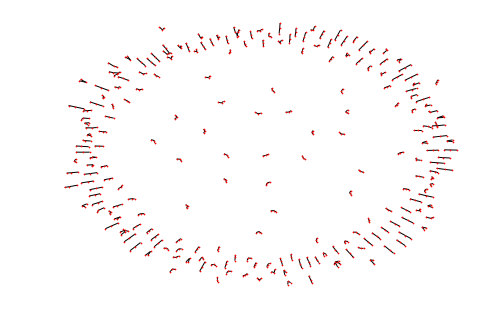

In [71]:
nx.draw(TEST_GRAPH, node_size=0.5)

## Test Predicate Combinations

In [68]:
# Create a new instance of TEST_GRAPH
WATER_GRAPH = create_graph_from_xyz('data/realwater.xyz')

# Calculate the distance arrays and add them to the graph.
add_distance_array_to_nodes(WATER_GRAPH)

# Create the predicate functions.
water_distance_check = functools.partial(distance_check, low=0.9, high=1.0)
O_H_check = functools.partial(element_check, element_set=set(['O', 'H']))

# Apply the predicates to create edges.
add_conditional_edge(predicates=[water_distance_check, O_H_check], graph=WATER_GRAPH)

# View the graph.
draw_plotly_3d_scatter(WATER_GRAPH)

## Get edge list

In [69]:
# Returns the list of edges by node indicies.
# WATER_GRAPH.edges()

### Format Edge List for Micro States

Data is expected as a list of node edges with extra values.

```
1 104 0 0 0 1 3 1.876 164.37
2 27 0 0 0 1 2 1.819 168.96
2 94 0 0 0 2 1 2.004 157.40
3 94 0 0 0 1 3 2.042 149.42
3 129 0 0 0 1 3 2.106 146.63
3 210 0 0 0 2 1 1.834 154.15
4 23 0 0 0 3 1 1.801 148.98

```

In [32]:
def create_microstate_input(in_graph, output_filename='micro_in.txt'):
    """Creates a file for use in input for Andrews code..."""
    
    # Get the edges and convert them to a normal Python list.
    edge_list = list(WATER_GRAPH.edges())
    
    # There are seven other values -- for now these can be zero.
    empty_vals = [0 for x in range(7)]
    
    # Create the empty output list.
    output = list()
    
    # Iterate through the edges and combine the edge indicies and the zero vals.
    for ni, nj in edge_list:
        
        # Create a list for this row.
        row_list = list()
        
        # Extend the values so there are no nested lists.
        row_list.extend([ni, nj])
        row_list.extend(empty_vals)

        # Append the row list to the output list.
        output.append(row_list)
    
    # Write the output file.
    with open(output_filename, 'w') as out_file:
        for line in output:
            out_file.write(f'{line}\n')
    
    # Return the list output.
    return output

In [33]:
microstate_input_list = create_microstate_input(WATER_GRAPH)
microstate_input_list[0]

[0, 1, 0, 0, 0, 0, 0, 0, 0]

## Dipole Moment Calculation

Implementation of a simple dipole moment calculation. This is just the average position of the two hydrogens with edges to an oyxgen atom.

In [34]:
def calculate_dipole_vectors(graph):
    """Calculate the dipole vectors for waters found within graph.
    
    This functinon assumes that the paths / edges between the have
    already be created.
    
    :param graph:
        A graph object. Must have the paths from oxygen to hydrogen
        already in place.
        
    :returns:
        Modifies the given graph in place.
    """
    
    # Iterate through those atoms within the graph.
    for nd in graph.nodes():
        
        # We only care about nodes that are oxygen.
        if graph.node('element')[nd] == 'O':
            
            # Get the index of this oxygen.
            oxy_idx = get_node_xyz(nd, graph)
            
            # Ensure that we only consider oxygens with only two
            # neighbors.
            if len(graph[nd]) == 2:
                
                # Get the neighbors of the oxygen node. These are the
                # graph indixes of the hydrogens.
                h_nbrs = [get_node_xyz(n, graph) for n in graph[nd]]
                
                # Calculate the mean of these two vectors. Append this
                # value to the current node.
                dpv = np.mean([h_nbrs[0], h_nbrs[1]], axis=0)
                graph.add_node(node_for_adding=nd, dipole_vector=dpv)

In [35]:
calculate_dipole_vectors(WATER_GRAPH)

In [36]:
# print([x for x in nx.get_node_attributes(WATER_GRAPH, 'dipole_vector').values()])

In [37]:
def draw_water_dipoles(in_graph):
    """COMMENT ME!"""
    
    # Get the coordinate attributes back out of the graph.
    x_vals = [x for x in nx.get_node_attributes(in_graph, 'x').values()]
    y_vals = [x for x in nx.get_node_attributes(in_graph, 'y').values()]
    z_vals = [x for x in nx.get_node_attributes(in_graph, 'z').values()]
    
    # Create the color and size lists.
    c_vals = [x for x in nx.get_node_attributes(in_graph, 'color').values()]
    s_vals = [x for x in nx.get_node_attributes(in_graph, 'size').values()]
    
    # Add the points to a scatter plot.
    trace1 = go.Scatter3d(
        x=x_vals,
        y=y_vals,
        z=z_vals,
        mode='markers',
        hovertext = [x for x in in_graph.nodes()],
        marker=dict(
            sizemode='area',
            color=c_vals,
            size=s_vals,
            opacity=0.8
        ),
    )
    
    # Create empty list for line segments.
    Xe=[]
    Ye=[]
    Ze=[]
    
    # Iterate through the edges, and draw line segments for each set.
    for nd in tqdm_notebook(in_graph.node()):

        if in_graph.node('element')[nd] == 'O':
        
            # Assign the x, y, z variables.        
            xa = in_graph.node('x')[nd]
            ya = in_graph.node('y')[nd]
            za = in_graph.node('z')[nd]

            xb, yb, zb = in_graph.node('dipole_vector')[nd]

            # Add these values to a corresponding list.
            # The third value is none, otherwise a plane would be drawn.
            Xe += [xa, xb, None]
            Ye += [ya, yb, None]
            Ze += [za, zb, None]

    # Add the node edges / line segments to the plot.
    trace2 = go.Scatter3d(
        x=Xe,
        y=Ye,
        z=Ze,
        mode='lines',
        line=go.Line(color='black', width=3),
        hoverinfo='none'
    )

    # Show the plot.
    data = [trace1, trace2]
    fig = go.Figure(data=data)
    iplot(fig)

In [38]:
draw_water_dipoles(WATER_GRAPH)

HBox(children=(IntProgress(value=0, max=648), HTML(value='')))

## Further Exploration

Try only oxygen oxygen bonds... A cool matrix.

## Hydrogen Bonds

In [73]:
# Create a new instance of TEST_GRAPH
hydrogen_bonds = create_graph_from_xyz('data/realwater.xyz')

# Calculate the distance arrays and add them to the graph.
add_distance_array_to_nodes(hydrogen_bonds)

# Create the predicate functions.
water_distance_check = functools.partial(distance_check, low=1.0, high=2.0)
O_H_check = functools.partial(element_check, element_set=set(['O', 'H']))

# Apply the predicates to create edges.
add_conditional_edge(predicates=[water_distance_check, O_H_check], graph=hydrogen_bonds)

# View the graph.
draw_plotly_3d_scatter(hydrogen_bonds)

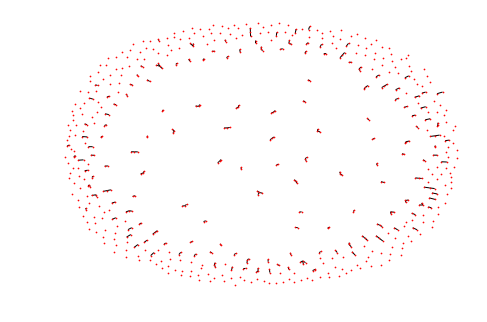

In [74]:
nx.draw(hydrogen_bonds, node_size=0.5)

## Oxygen Oxygen Bonds

In [75]:
# Create a new instance of TEST_GRAPH
oo_graph = create_graph_from_xyz('data/realwater.xyz')

# Calculate the distance arrays and add them to the graph.
add_distance_array_to_nodes(oo_graph)

# Create the predicate functions.
water_distance_check = functools.partial(distance_check, low=2.0, high=4.0)
O_H_check = functools.partial(element_check, element_set=set(['O', 'O']))

# Apply the predicates to create edges.
add_conditional_edge(predicates=[water_distance_check, O_H_check], graph=oo_graph)

# View the graph.
draw_plotly_3d_scatter(oo_graph)

In [76]:
plot_degree_histogram(oo_graph)

In [81]:
# Isolate the nodes with edges.
oxygen_nodes = [n for n, v in oo_graph.nodes(data=True) if v['element'] == 'O']

# Create a subgraph.
oo_subgraph = oo_graph.subgraph(oxygen_nodes)

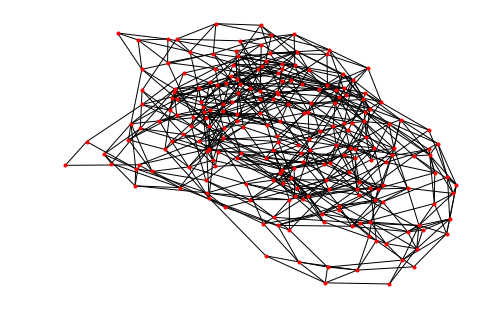

In [86]:
nx.draw(oo_subgraph, node_size=9)

### Edge Labeling and Weighting

Separate from the predicate functions.

In [42]:
def add_edge_weight(weighting_functions, graph, label=None):
    
    edge_list = nx.edges(graph)
    
    # Go through each edge.
    for curr_edge in edge_list:
                
        edge_attrs  = dict()
        
        # For each function given to analyze the edge.
        for wt_func in weighting_functions:
            
            # Apply the function.
            func_dict = wt_func(curr_edge, graph)
            # All of these functions should return a dictionary.

            # Merge these dictionaries, and pass them to the edge.
            # Some nifty python3.5+ short hand.
            # https://stackoverflow.com/a/26853961
            edge_attrs = {**edge_attrs, **func_dict}
        
        n1, n2 = curr_edge

        graph.add_edge(n1, n2, **edge_attrs)

In [43]:
def add_distance_weight_to_edge(in_edge, graph):
    
    n1, n2 = in_edge

    # Get the distance array from the first node.
    node1_distance_array = graph.node('distance_array')[n1]

    # The distance between the two nodes can be looked up from
    # the distance_array by using the index of the second ndoe.
    n1_n2_dist = node1_distance_array[n2]
    
    return {'distance': n1_n2_dist}

In [44]:
add_edge_weight([add_distance_weight_to_edge], oo_graph)

## FLoyd Warshall - Shortest Paths

In [45]:
# nx.floyd_warshall(oo_graph, weight='distance')

## Waters with Hydrogen Bonds

Find all waters, then add all hydrogen bonds.

In [46]:
# Create a new instance of TEST_GRAPH
WHP = create_graph_from_xyz('data/realwater.xyz')

# Calculate the distance arrays and add them to the graph.
add_distance_array_to_nodes(WHP)

# Add the euclidean distance to each edge.
add_edge_weight([add_distance_weight_to_edge], WHP)

# Create the predicate functions for water.
water_distance_check = functools.partial(distance_check, low=0.1, high=1.0)
O_H_check = functools.partial(element_check, element_set=set(['O', 'H']))

# Apply the predicates to create edges.
add_conditional_edge(predicates=[water_distance_check, O_H_check], graph=WHP)

# Create predicate functions for hydrogen bonds.
h_bond_check = functools.partial(distance_check, low=1.6, high=2.1)

add_conditional_edge(predicates=[h_bond_check, O_H_check], graph=WHP)

# View the graph.
draw_plotly_3d_scatter(WHP)

In [47]:
plot_degree_histogram(WHP)

In [48]:
whp_fw = nx.floyd_warshall(WHP, weight='distance')

In [49]:
def plot_fw_hist(fw_dict):
    """Plot a degree histogram of a given floyd warshall dict."""
    path_list = list()
    
    for node_idx, dist_list in fw_dict.items():
        
        node_dict = [v for k, v in dist_list.items() if v <= 100]
        path_list.extend(node_dict)

    path_list = np.array(sorted(path_list, reverse=True))
        
    data = [go.Histogram(x=path_list, histnorm='probability')]
    
    iplot(data)

In [50]:
def plot_fw_hist(in_graph, fw_dict, element_set=set(['O', 'H'])):
    """Plot a degree histogram of a given in_grpah.
    
    """
    
    trace_list = list()
    # Iterate through the provided set to generate the trace.
    for element in element_set:
        
        path_list = list()
        
        for node_idx, dist_list in fw_dict.items():
            
            if in_graph.node('element')[node_idx] == element:
                
                path_list.extend([v for k, v in dist_list.items() if v <= 100])
                
        path_list = np.array(sorted(path_list, reverse=True))

                
            
        new_trace = go.Histogram(
            x=path_list,
            name=element
        )
        trace_list.append(new_trace)
        
    layout = go.Layout(
        title='Edge Count Histogram',
        xaxis=dict(title='Edge Count'),
        yaxis=dict(title='Observed Count'))
    
    fig = go.Figure(data=trace_list, layout=layout)
    iplot(fig)

In [51]:
plot_fw_hist(WHP, whp_fw)

In [52]:
def pairwise(iterable):
    "s -> (s0,s1), (s1,s2), (s2, s3), ..."
    a, b = itertools.tee(iterable)
    next(b, None)
    return zip(a, b)


def rdf(in_graph, bin_width=0.03, element='O'):
    """    """
    element_nodes = [n for n,v in in_graph.nodes(data=True) if v['element'] == element]
    # Get the distance arrays from the input graph.
    distance_arrays = np.array([x for x in nx.get_node_attributes(in_graph, 'distance_array').values()])
    distance_arrays = [np.trim_zeros(distance_arrays[i]) for i in element_nodes]
        
    for idx, da in enumerate(distance_arrays):
        distance_arrays[idx] = [da[i] for i in element_nodes]
    
    # Calculate the box size.
    box_size = get_box_size(in_graph)
    
    # Get the largest possible vector?
    # Use that value for the maximum range of the bins.
    box_vector = np.linalg.norm(box_size)
    
    # Calculate the number density.
    number_density = len(distance_arrays) / box_vector
        
    # Create the bins for the histogram.
    # This models the slices / layers around the atom of interest.
    atom_bins = np.arange(2.3, 5.0, bin_width)

    # Calculate the sphere cuts volume array.
    sphere_cut_ranges = np.array([pair for pair in pairwise(atom_bins)])
    sphere_volumes = 4.0 / 3.0 * np.pi * sphere_cut_ranges**3
    sphere_cut_volumes = sphere_volumes[..., 1] - sphere_volumes[..., 0]

    # Enumerate through the distance arrays, these indexes are the same as the atoms.
    # First create an zeroed numpy array to hold the values.
    # The -1 is due to the pair-wise usa above.
    bins_collected = np.zeros((len(in_graph), len(atom_bins) - 1))

    for atom, da in enumerate(distance_arrays):
        
        # Bin them by range increments.
        bin_counts, bin_edges = np.histogram(da, bins=atom_bins)
        
        # Assign them to the bins_collected array.
        bins_collected[atom] = bin_counts
    
    # Sum the extracted bin counts.
    summed_bins = np.sum(bins_collected, axis=0)
    
    # Normalize the sums by dividing by the volumes and number density.
    normalized_bins = summed_bins / sphere_cut_volumes / number_density
    
    XX = atom_bins[:-2]
    YY = normalized_bins[1:]

    # Create the trace for plotly.
    trace = go.Scatter(
        x = XX,
        y = YY,
        mode = 'markers',
        name='RDF')
    
    # generate the 2nd order fitting polynomial:
    p = np.polyfit(XX, YY, 8)

    # now, compute the fit using your polynomial:
    y_fit = np.polyval(p, XX)
    
    # Create a trace for fun.
    trace_fit = go.Scatter(
        x = XX,
        y = y_fit,
        name='Polynomial fit')

    data = [trace, trace_fit]

    iplot(data)

In [53]:
rdf(WHP)